<a href="https://colab.research.google.com/github/nik1997/capstone2020/blob/master/CS146_Final_Assingment_Stock_Forecast_Returns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import string
import pystan
import seaborn
import time

In [0]:
# The modeling and sampling takes a while (more than 10 minutes, so playing
# the beep sound to know that the task has completed)
# Only works with Google Colab

try:
  from google.colab import output
  IN_COLAB = True
  # Play an audio beep. Any audio URL will do.
except:
  IN_COLAB = False

def beep():
    if IN_COLAB:
       output.eval_js('new Audio("https://upload.wikimedia.org/wikipedia/commons/0/05/Beep-09.ogg").play()') 
    else:
        print('Task completed!')

beep()

# CS146 Final Assignment - Modeling Stock returns

In [2]:
# reading monthly data
url_data = 'https://github.com/nik1997/capstone2020/raw/master/data/Returns_handbook_data.xls'
data = pd.read_excel(url_data, 'Monthly')
data.head()

,Date (yyyymm),S&P 500 index,12-month moving sum of S&P 500 dividends,12-month moving sum of S&P 500 earnings,DJIA book-to-market value ratio,3-month Treasury bill yield (secondary market),Moodys AAA-rated corporate bond yield,Moodys BAA-rated corporate bond yield,Long-term government bond yield,Net equity expansion,Risk-free rate,CPI (all urban consumers) inflation rate,Long-term government bond return,Long-term corporate bond return,Monthly sum of squared daily returns on S&P 500 index,CRSP S&P 500 value-weighted return with dividends,CRSP S&P 500 value-weighted return excluding dividends,NBER recession dummies,NBER recession dummies with peak included
0,187101.0,4.44,0.26,0.4,NaN,NaN,NaN,NaN,NaN,NaN,0.004955,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,187102.0,4.50,0.26,0.4,NaN,NaN,NaN,NaN,NaN,NaN,0.004514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,187103.0,4.61,0.26,0.4,NaN,NaN,NaN,NaN,NaN,NaN,0.004243,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,187104.0,4.74,0.26,0.4,NaN,NaN,NaN,NaN,NaN,NaN,0.004632,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,187105.0,4.86,0.26,0.4,NaN,NaN,NaN,NaN,NaN,NaN,0.003691,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
print('All column names')
print('--'*20)
for idx in range(len(data.columns)):
    print(idx, '--', data.columns[idx])

All column names
----------------------------------------
0 -- Date (yyyymm)
1 -- S&P 500 index
2 -- 12-month moving sum of S&P 500 dividends
3 -- 12-month moving sum of S&P 500 earnings
4 -- DJIA book-to-market value ratio
5 -- 3-month Treasury bill yield (secondary market)
6 -- Moodys AAA-rated corporate bond yield
7 -- Moodys BAA-rated corporate bond yield
8 -- Long-term government bond yield
9 -- Net equity expansion
10 -- Risk-free rate
11 -- CPI (all urban consumers) inflation rate
12 -- Long-term government bond return
13 -- Long-term corporate bond return
14 -- Monthly sum of squared daily returns on S&P 500 index
15 -- CRSP S&P 500 value-weighted return with dividends
16 -- CRSP S&P 500 value-weighted return excluding dividends
17 -- NBER recession dummies
18 -- NBER recession dummies with peak included


In [4]:
print('Shape of dataset:', data.shape)

Shape of dataset: (1682, 19)


### The y-varible log-excess return

In [0]:
# Equity premium

idx_first = 671 # starting data 1926:11 from the Excel file
idx_last = 1679 # final date 2010:12 from the Excel file

market_return = np.array(data.loc[idx_first:idx_last, ['CRSP S&P 500 value-weighted return with dividends']]).flatten()
r_f_lag = np.array(data.loc[(idx_first-1):(idx_last-1), 'Risk-free rate']) # risk free rate
equity_premium = np.log(1+market_return)-np.log(1+r_f_lag) # log excess return

### The variables

In [0]:
#dividends
d12=np.array(data.loc[idx_first:idx_last, '12-month moving sum of S&P 500 dividends']) 
#S7P 500 index
sp500 = np.array(data.loc[idx_first:idx_last, 'S&P 500 index']) 
# log dividend-price ratio
dp = np.log(d12) - np.log(sp500) 
# S&P 500 index, lagged 
sp500_lag = np.array(data.loc[(idx_first-1):(idx_last-1), 'S&P 500 index']) # S&P 500 index, lagged 
# log dividend yield
dy = np.log(d12) - np.log(sp500_lag)
# earnings
e12 = np.array(data.loc[idx_first:idx_last, '12-month moving sum of S&P 500 earnings'])
# log earnings to price ratio
ep = np.log(e12) - np.log(sp500)
# log dividend-payout ratio
de = np.log(d12) - np.log(e12)
# volatility (SVAR)
svar = np.array(data.loc[idx_first:idx_last, 'Monthly sum of squared daily returns on S&P 500 index'])
# book to market ratio
bm = np.array(data.loc[idx_first:idx_last, 'DJIA book-to-market value ratio'])
# net equity issuing activity
ntis=np.array(data.loc[idx_first:idx_last, 'Net equity expansion'])
# t-bill raate
tbl = np.array(data.loc[idx_first:idx_last, '3-month Treasury bill yield (secondary market)'])
# long-term government bond yield
lty = np.array(data.loc[idx_first:idx_last, 'Long-term government bond yield'])
# long-term governmnent bond return
ltr = np.array(data.loc[idx_first:idx_last, 'Long-term government bond return'])
# term spread
tms=lty-tbl
# AAA-rated corporate bond yield
aaa = np.array(data.loc[idx_first:idx_last, 'Moodys AAA-rated corporate bond yield'])
# BAA-rated corporate bond yield
baa = np.array(data.loc[idx_first:idx_last, 'Moodys BAA-rated corporate bond yield'])
# Default yield spread
dfy = baa-aaa
# Long-term corporate bond return
corpr = np.array(data.loc[idx_first:idx_last, 'Long-term corporate bond return'])
# Default return spread
dfr = corpr - ltr
# Inflation, lagged(1926:11-2010:11)
infl_lag = np.array(data.loc[(idx_first-1):(idx_last-1), 'CPI (all urban consumers) inflation rate'])

### The 14 predictors are:

- dp => log dividend-price ratio
- dy => Log dividend yield
- ep => Log earnings to price ratio
- de => Log dividend payout ratio 
- svar => stock variance
- bm => book to market ratio 
- ntis => net equity issuing activity
- tbl => t-bill rate
- lty => long-term governmnent bond yield
- ltr => long-term governmnent bond return
- tms => term spread
- dfy =>  Default yield spread
- dfr => Default return spread
- inf_lag => Inflation

In [0]:
# added 1s, for getting the coefficient of the constant in the linear equation
X = np.column_stack((np.ones(len(dp)), dp, dy, ep, de, svar, bm, ntis, tbl, lty, ltr, tms, dfy, dfr, infl_lag))

In [8]:
# Splitting the dataset into 70% and 30% for training and testing

num_in_sample = int(0.7 * len(equity_premium))
idx_out_sample_start = num_in_sample + 1
num_out_sample = len(equity_premium) - num_in_sample

# Spliting dataset into training and test
X_train = X[:num_in_sample]
X_test = X[num_in_sample:]
Y_train = equity_premium[:num_in_sample]
Y_test = equity_premium[num_in_sample:]

print('Number of samples in in-sample', num_in_sample)
print('Number of samples in out-sample: ', num_out_sample)

Number of samples in in-sample 706
Number of samples in out-sample:  303


In [9]:
def normalize_value(val, max_val, min_val):
    '''
        The returns the normalized version of an value, given
        the maximum value and minimum value in the data_column

        Using formula:

        Norm value = (x_i - (a+b)/2) / ((a-b)/2)
    '''
    return (val - (max_val + min_val)/2) / ((max_val - min_val)/2)

def normalize_data(X_train, X_test):
    '''
        Normalizes the dataset to (-1, to 1); and uses ranges from the training
        data, to normalize the testing data.
    '''

    X_train_normalized = X_train[:, 0] # the first columns are just ones for constants
    X_test_normalized = X_test[:, 0]

    for i in range(1, X_train.shape[1]):
        max_val = np.max(X_train[:, i])
        min_val = np.min(X_train[:, i])

        col_normalized_train = [normalize_value(val, max_val, min_val) for val in X_train[:, i]] 
        col_normalized_test = [normalize_value(val, max_val, min_val) for val in X_test[:, i]]

        X_train_normalized = np.column_stack((X_train_normalized, col_normalized_train))
        X_test_normalized = np.column_stack((X_test_normalized, col_normalized_test))

    return X_train_normalized, X_test_normalized

X_train_norm, X_test_norm = normalize_data(X_train, X_test)

print('Shape of X_train_norm: ', X_train_norm.shape)
print('Shape of X_test_norm: ', X_test_norm.shape)

Shape of X_train_norm:  (706, 15)
Shape of X_test_norm:  (303, 15)


/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


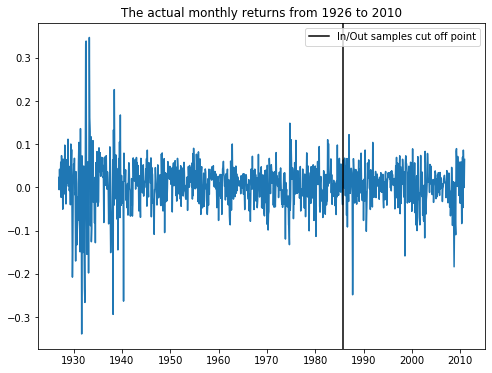

In [10]:
# Creating an array of dates to for plotting purposes
def change_to_date_time_string(num_date):
    '''
        The original data set stores the dates in numbers as format yyyymm, 
        which has been converted into integer

        This function gets the date as integer, and converts into string format of
        YYYY-MM-DD, where DD for each date is assumed to be 01
    '''
    str_date = str(num_date)
    remodified_date = '{0}-{1}-01'.format(str_date[:4], str_date[4:6])
    return remodified_date

# Converting the number dates to date and time
date_strings = data.loc[idx_first:idx_last, 'Date (yyyymm)'].apply(change_to_date_time_string)
dates = pd.to_datetime(date_strings)
dates = np.array(dates)
dates_train = dates[:num_in_sample]
dates_test = dates[num_in_sample:]


# plotting the actual returns
plt.figure(figsize=(8, 6))
equity_premium[num_in_sample]
plt.plot(dates, equity_premium)
plt.axvline(dates[num_in_sample], 
            label='In/Out samples cut off point',
            color='k')
plt.title('The actual monthly returns from 1926 to 2010')
plt.legend()
plt.show()

## Metrics

I am using MSFE and $R^2_{OS}$ as my metrics for model comparison, which are given by following equations.


$$MSFE_i = \frac{1}{n_2} \sum_{s=1}^{n_2}(r_{n_1+s}-\hat{r}_{i, n_1+s})^2$$
where, $\hat{r}$ is the prediction.

$$MSFE_o = \frac{1}{n_2} \sum_{s=1}^{n_2}(r_{n_1+s}-\overline{r}_{n_1+s})^2$$
where, $\overline{r_{t+1}}=\frac{1}{t}\sum_{s=1}^{t}r_t$

Then, 
$$R^2_{OS} = 1 - (MSFE_i / MSFE_0)$$

$R^2_{OS}$ compares the MSFE of the model with historical average benchmark forecast.

In [0]:
def calc_msfe(y_actual, y_predictions):
    '''
        Calculates Mean Squared Forecast Error (MSFE) between the predicted and
        actual value.
    '''
    n = len(y_actual)
    errors = [(y_actual[i]-y_predictions[i])**2 for i in range(n)]
    return np.sum(errors)/n

def calc_historical_average_return_forecast(returns, num_out_sample):   
    '''
        Computes the historical average return forecast.
        The forecast is estimated as the average return of all the past time periods, as
        defined in teh equation above.
    '''
    forecasted_returns = [(np.sum(returns[:t])/t) for t in range(1, len(returns))]
    return forecasted_returns[((-1)*num_out_sample):]

def calc_r2_os(y_actual, y_predictions, benchmark_predictions):
    '''
        Computes the R2_os score for each model by comparing it with the MSFE of
        historical average return forecast
    '''
    msfe_i = calc_msfe(y_actual, y_predictions)
    msfe_0 = calc_msfe(y_actual, benchmark_predictions)
    return 1 - (msfe_i / msfe_0)

# getting the historical benchmark forecast
benchmark_predictions = calc_historical_average_return_forecast(equity_premium, num_out_sample)

## Helper functions: Plotting and calculating error scores

In [0]:
def plot_predictions(predictions, dates=dates_test, y_actual=Y_test, model_name='N/A'):
    '''
        Plots predictions and their confidence interval against the actual data points

        Returns:
        (float) % of actual data points outside of confidence interval
    '''
    # Compute 95% interval and median of the predicted values
    prediction_interval = np.percentile(predictions, axis=0, q=[2.5, 97.5])

    prediction_mean = np.mean(predictions, axis=0)
    
    plt.figure(figsize=(16, 8))

    # plotting Predictions against actual returns
    # plt.plot(dates_train, Y_train, 'k-', label='actual in of sample of returns')
    plt.plot(dates, y_actual, 'k--', label='actual out of sample returns')

    # plt.axvline(dates[num_in_sample], color='r', label='In/Out Sample cut off')

    plt.plot(dates, prediction_interval[0, :], 'b-', label='95% prediction interval')
    plt.plot(dates, prediction_interval[1, :], 'b-')

    plt.plot(dates, prediction_mean, 'b--', label='mean predictions')

    plt.title('Comparision of actual returns and predictions by {0}'.format(model_name))
    plt.legend()
    plt.show()

    return calc_data_outside__ci(y_actual, prediction_interval[0, :], prediction_interval[1, :])

def calc_data_outside__ci(y_actual, lower_bound, upper_bound):
    '''
        It calculates the percentage of actual data points outside of the confidence
        interval.
        The number of valuse outside of the range is expected to be at around 5%.
    '''
    num_vals_out_of_range = len(np.where((y_actual < lower_bound) | (y_actual > upper_bound))[0])
    return num_vals_out_of_range / len(y_actual)

def plot_acf(x):
    '''
    Plot the autocorrelation function for a series x. This corresponds to the
    acf() function in R. The series x is detrended by subtracting the mean of
    the series before computing the autocorrelation.
    '''
    from scipy import signal
    plt.acorr(
        x, maxlags=20, detrend=lambda x: signal.detrend(x, type='constant'))
    

In [0]:
# Dictionaries to store samples and results
dict_samples = {}
dict_results = {}
dict_r2os = {}
dict_msfe = {}
dict_data_outside_ci = {}

In [0]:
def calc_and_store_error_scores(predictions, model_name, n_outside_ci):
    '''
        Calculates the R2_os and MSFE score for each model
        based on their predictions
    '''

    dict_data_outside_ci[model_name] = n_outside_ci
    dict_r2os[model_name] = calc_r2_os(Y_test, 
                                np.mean(predictions, axis=0),
                                benchmark_predictions)
    dict_msfe[model_name] = calc_msfe(Y_test, 
                                np.mean(predictions, axis=0))
    print('R2OS is ', dict_r2os[model_name])
    print('MSFE on test is ', dict_msfe[model_name])
    print('% of actual points outside of confidence interval: ', n_outside_ci)

## Bayesian Linear model in Stan

In [14]:
# The Stan model. Running this cell compiles the Stan model, which takes
# some time

stan_code_blm = """
data {
    int<lower=0> n_var;       // Number of predictor variables

    int<lower=0> num_in_sample;  // The out of sample cut off point
    int<lower=0> num_out_sample;   // Number of predictions to generate
    
    // Knwon predictors
    matrix[num_in_sample, n_var] X_train;    // data matrix for training
    matrix[num_out_sample, n_var] X_test;    // data matrix for predictions and testing

    // Known log excess returns
    real y_train[num_in_sample];  // log-returns for trainings
    real y_test[num_out_sample];   // log-returns from out of sample
    
    // Hyper parameters for priors
    real beta_mean;  // The mean hyperparameter for prior of betas
    real beta_std;  // The std hyperparameter for prior of betas
    real sigma_alpha;    // The mean hyperparameter for prior of sigma
    real sigma_beta;     // The std hyperparameter for prior of sigma
}

parameters {
    vector[n_var] beta; // Vector with coefficients for each variable
    real sigma; // Std deviation for normal distribution, error parameter
}

model {

    beta ~ normal(beta_mean, beta_std);
    sigma ~ gamma(sigma_alpha, sigma_beta);

    for (i in 2:num_in_sample) {
        y_train[i] ~ normal(dot_product(beta, X_train[i-1]), sigma);
    }
}

// Generate the predicted function values for the next n_future steps.
generated quantities {
    real y_pred[num_out_sample];

    // first prediction is done using the last set of values in X as 
    // The predictors lag one period behind the estimated returns.
    y_pred[1] = normal_rng(
            dot_product(beta, X_train[num_in_sample]),
            sigma);

    // All other predictions are one step forward
    for(t in 2:num_out_sample) {
        y_pred[t] = normal_rng(
            dot_product(beta, X_test[t]),
            sigma);
    }
}
"""

start = time.time() # timer started

stan_model_blm = pystan.StanModel(model_code=stan_code_blm)

print('Model Compiled')
print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_eeb40680f1f13dc2069ca9c4aca6466d NOW.


Model Compiled
----------------------------------------
Time taken: 60.9077s


In [15]:
stan_data_blm = {
    'n_var': X[:-1].shape[1],
    'num_in_sample': num_in_sample,
    'num_out_sample': num_out_sample,
    'X_train': X_train_norm,
    'X_test': X_test_norm,
    'y_train': Y_train,
    'y_test': Y_test,
    'beta_mean': 0,
    'beta_std': 1,
    'sigma_alpha': 0.5,
    'sigma_beta': 1
} 

start = time.time() # timer started

parameters = ['beta', 'sigma']
dict_results['blm'] = stan_model_blm.sampling(data=stan_data_blm)
print(dict_results['blm'].stansummary(pars=parameters))
dict_samples['blm'] = dict_results['blm'].extract()

print('Model Compiled')
print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

Inference for Stan model: anon_model_eeb40680f1f13dc2069ca9c4aca6466d.
4 chains, each with iter=2000; warmup=1000; thin=1; 
post-warmup draws per chain=1000, total post-warmup draws=4000.

            mean se_mean     sd    2.5%     25%     50%    75%  97.5%  n_eff   Rhat
beta[1]  -3.7e-3  2.8e-3   0.08   -0.16   -0.06 -3.9e-3   0.05   0.15    839   1.01
beta[2]    -0.06    0.02   0.66   -1.35   -0.51   -0.06   0.37   1.24    824   1.01
beta[3]     0.06  5.5e-4   0.03 -4.2e-3    0.04    0.06   0.09   0.13   3915    1.0
beta[4]    -0.01    0.02   0.55   -1.12   -0.37   -0.02   0.36   1.08    820   1.01
beta[5]    -0.04    0.02   0.48   -0.99   -0.35   -0.04   0.28   0.91    820   1.01
beta[6]   3.6e-3  2.8e-4   0.02   -0.03 -8.0e-3  3.5e-3   0.02   0.04   4002    1.0
beta[7]     0.04  3.2e-4   0.02  5.9e-3    0.03    0.04   0.06   0.08   3223    1.0
beta[8]  -5.1e-3  2.1e-4   0.01   -0.03   -0.01 -5.3e-3 3.4e-3   0.02   3552    1.0
beta[9]     0.01    0.02   0.74   -1.37   -0.51  6.5e-3

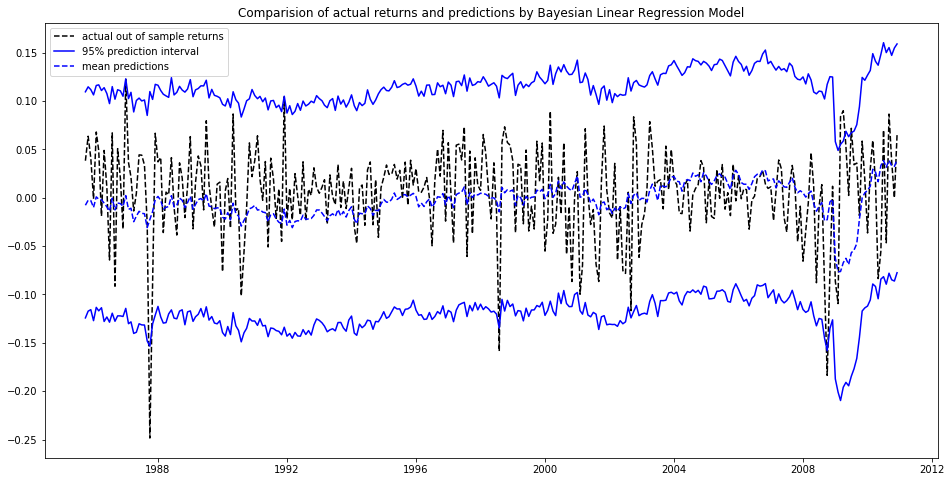

------------------------------------------------------------
Error scores for Bayesian Linear Regression Model
------------------------------------------------------------
R2OS is  -0.021602330805970293
MSFE on test is  0.0021834597692912006
% of actual points outside of confidence interval:  0.019801980198019802


In [46]:
# Plotting the predictions and calculating errors scores

n_outside_ci = plot_predictions(dict_samples['blm']['y_pred'], 
                 'Bayesian Linear Regression Model')

print('---'*20)
print('Error scores for Bayesian Linear Regression Model')
print('---'*20)
calc_and_store_error_scores(dict_samples['blm']['y_pred'], 'blm', n_outside_ci)

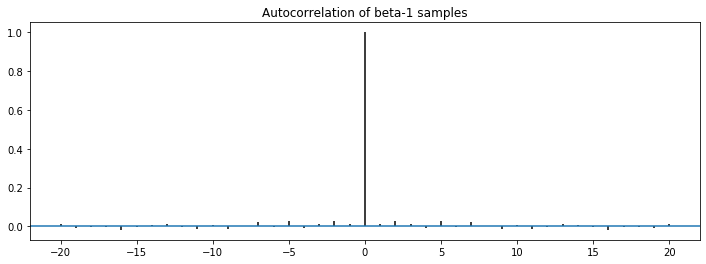

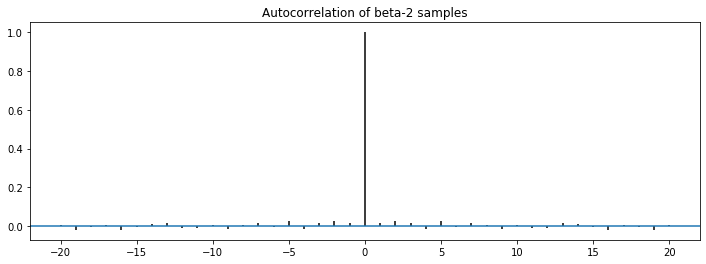

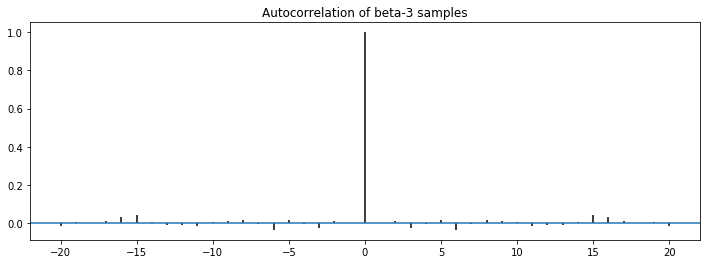

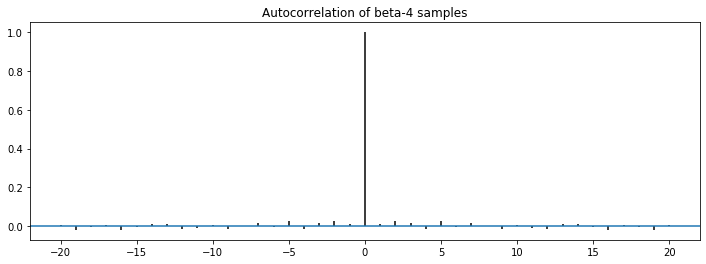

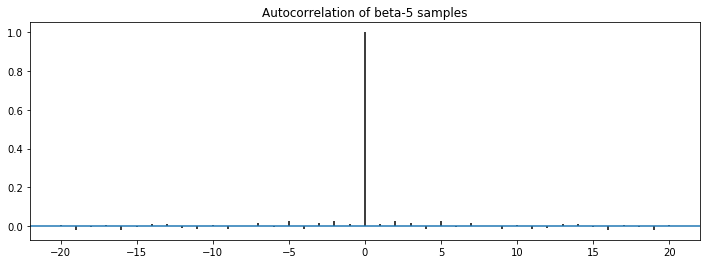

...

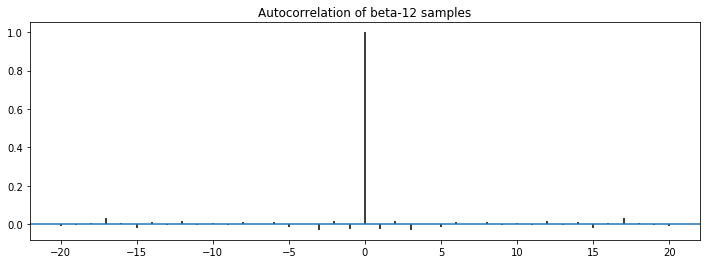

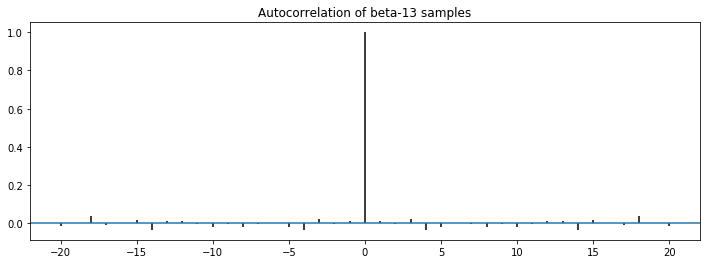

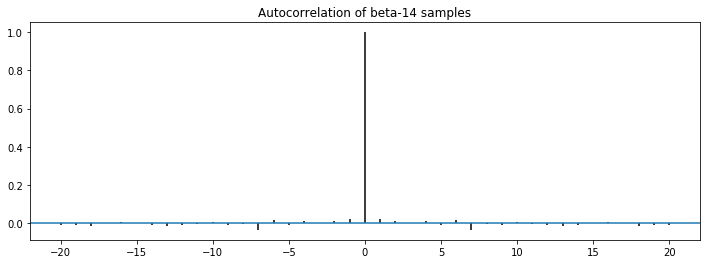

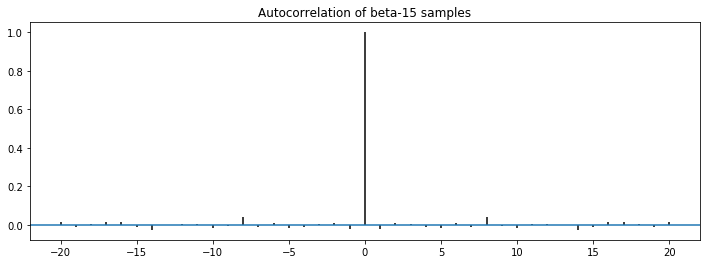

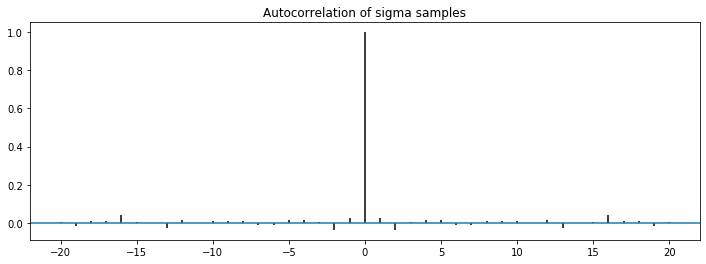

In [38]:
samples  = dict_samples['blm']

# Making Autocorrelation plot

arr_data = [samples['beta'][:,i] for i in range(samples['beta'].shape[1])]
arr_data.append(samples['sigma'])

arr_params = ['beta-{0}'.format(i+1) for i in range(samples['beta'].shape[1])]
arr_params.append('sigma')

for i in range(len(arr_params)):
    plt.figure(figsize=(12, 4))
    plot_acf(arr_data[i])
    plt.title(f'Autocorrelation of {arr_params[i]} samples')

plt.show()

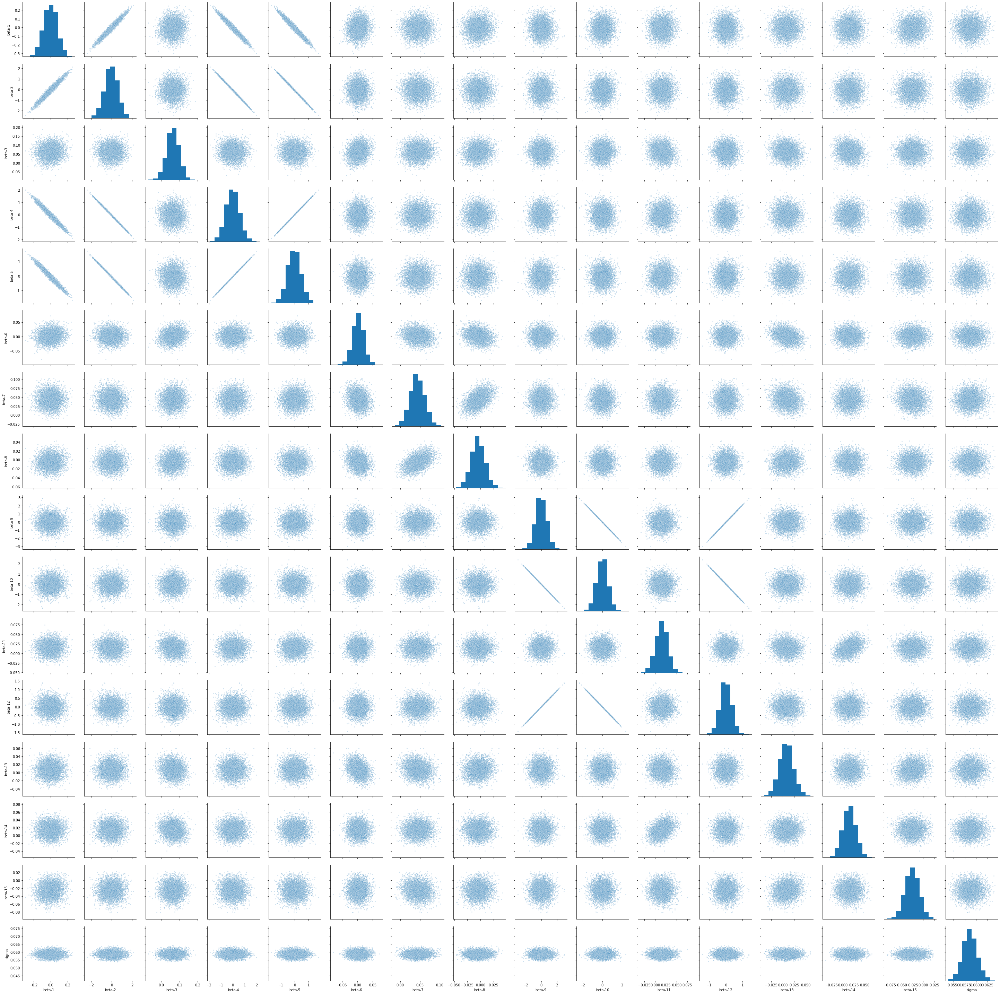

In [25]:
# Make pair plot of the posteriors over all parameters of the Bayesian linear regression model model.

df = pd.DataFrame(
    data=np.transpose(arr_data),
    columns=arr_params)
seaborn.pairplot(df, height=2.5, plot_kws={'marker': '.', 'alpha': 0.25})
plt.show()

# Auto-regression models

## AR-models with lag=1

In [68]:
stan_code_ar = """
data {
    int<lower=0> num_out_sample;  // The out of sample cut off point
    int<lower=0> num_in_sample;       // Number of predictions to generate

    real y_train[num_in_sample];     // in-sample log-returns
    real y_test[num_out_sample];     // out-of-sample log-returns

    real sigma_alpha;    // The alpha hyperparameter for prior of sigma
    real sigma_beta;     // The beta hyperparameter for prior of sigma
    real beta_mean;  // The mean hyperparameter for prior of betas
    real beta_std;  // The std hyperparameter for prior of betas
}

parameters {

    real beta; // Coefficient of the variable
    real sigma; // Standard deviation of the model
    real alpha;
}

model {

    beta ~ normal(beta_mean, beta_std);
    alpha ~ normal(beta_mean, beta_std);
    sigma ~ gamma(sigma_alpha, sigma_beta);
    for (i in 2:num_in_sample) {
        y_train[i] ~ normal(beta * y_train[i-1] + alpha, sigma);
    }
}

// Generate the predicted function values for the next n_future steps.
generated quantities {
    real y_pred[num_out_sample];

    // Getting the first prediction using the last in-sample data
    y_pred[1] = normal_rng(beta * y_train[num_in_sample], sigma);

    // The rest of the samples are generated using the first prediction
    for(t in 2:num_out_sample) {
        y_pred[t] = normal_rng(
            beta * y_pred[t-1] + alpha,
            sigma);
    }
}
"""

start = time.time() # timer started

stan_model_ar = pystan.StanModel(model_code=stan_code_ar)

print('Model Compiled')
print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_5e8663ca75b8e6125b94759dcb5d6e8b NOW.


Model Compiled
----------------------------------------
Time taken: 57.1362s


In [101]:
stan_data_ar_simple = {
    'num_in_sample': num_in_sample,
    'num_out_sample': num_out_sample,
    'y_train': Y_train,
    'y_test': Y_test,
    'beta_mean': 0,
    'beta_std': 1,
    'sigma_alpha': 0.5,
    'sigma_beta': 1
} 

start = time.time() #timer started

parameters = ['beta', 'sigma','alpha']
dict_results['ar_lag_1'] = stan_model_ar.sampling(data=stan_data_ar_simple)
print(dict_results['ar_lag_1'].stansummary(pars=parameters))
dict_samples['ar_lag_1'] = dict_results['ar_lag_1'].extract()

print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

Inference for Stan model: anon_model_5e8663ca75b8e6125b94759dcb5d6e8b.
4 chains, each with iter=2000; warmup=1000; thin=1; 
post-warmup draws per chain=1000, total post-warmup draws=4000.

        mean se_mean     sd    2.5%    25%    50%    75%  97.5%  n_eff   Rhat
beta    0.09  9.7e-4   0.04    0.02   0.07   0.09   0.12   0.17   1504    1.0
sigma   0.06  2.3e-5 1.6e-3    0.06   0.06   0.06   0.06   0.06   5147    1.0
alpha 4.1e-3  4.0e-5 2.2e-3 -2.9e-4 2.5e-3 4.0e-3 5.6e-3 8.3e-3   3173    1.0

Samples were drawn using NUTS at Fri Dec 20 13:39:32 2019.
For each parameter, n_eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor on split chains (at 
convergence, Rhat=1).
----------------------------------------
Time taken: 3.6462s


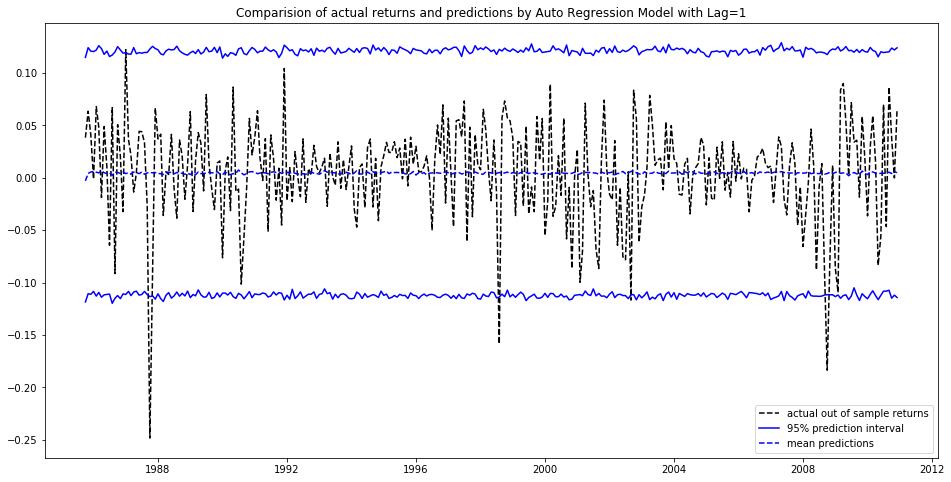

------------------------------------------------------------
Error scores for Auto Regression Model with Lag=1
------------------------------------------------------------
R2OS is  -0.001348026833194238
MSFE on test is  0.0021401704613618995
% of actual points outside of confidence interval:  0.0165016501650165


In [80]:
# Plotting and showing predictions

n_outside_ci = plot_predictions(dict_samples['ar_lag_1']['y_pred'],
                                dates_test, Y_test, 
                                'Auto Regression Model with Lag=1')

print('---'*20)
print('Error scores for Auto Regression Model with Lag=1')
print('---'*20)

calc_and_store_error_scores(dict_samples['ar_lag_1']['y_pred'], 'ar_lag_1', n_outside_ci)

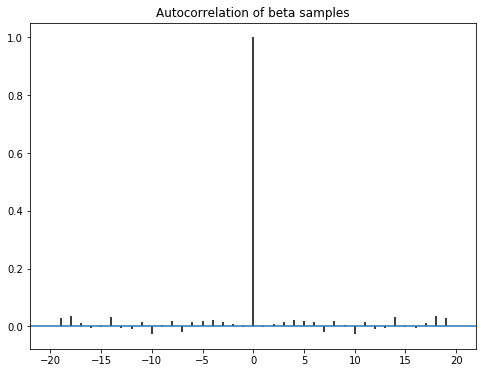

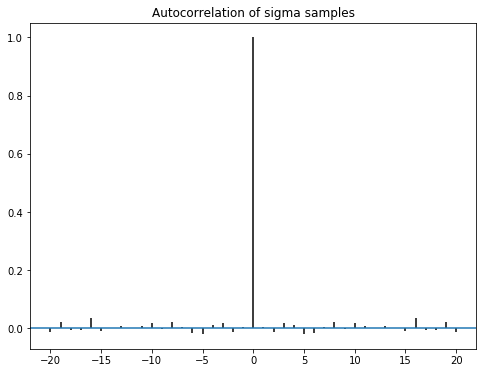

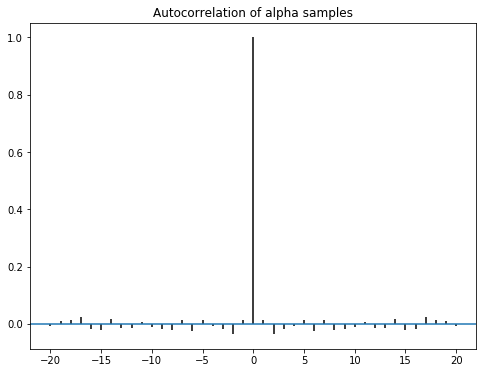

In [70]:
# Making Autocorrelation plot

samples = dict_samples['ar_lag_1']

for param in parameters:
    plt.figure(figsize=(8, 6))
    plot_acf(samples[param])
    plt.title(f'Autocorrelation of {param} samples')

plt.show()

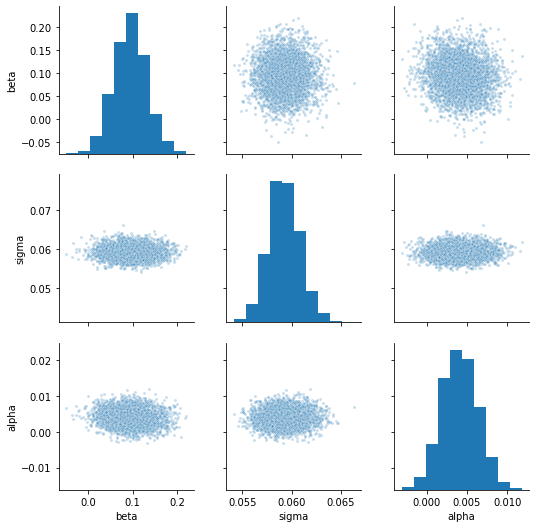

In [71]:
# Make pair plot of the posteriors over all parameters of the model.
df = pd.DataFrame(
    data=np.transpose([samples[param] for param in parameters]),
    columns=parameters)
seaborn.pairplot(df, height=2.5, plot_kws={'marker': '.', 'alpha': 0.25})
plt.show()

## AR models with lag = 2

In [72]:
stan_code_ar_lag_2 = """
data {
    int<lower=0> num_out_sample;  // The out of sample cut off point
    int<lower=0> num_in_sample;       // Number of predictions to generate

    real y_train[num_in_sample];     // in-sample log-returns
    real y_test[num_out_sample];     // out-of-sample log-returns

    real sigma_alpha;    // The alpha hyperparameter for prior of sigma
    real sigma_beta;     // The beta hyperparameter for prior of sigma
    real beta_mean;  // The mean hyperparameter for prior of betas
    real beta_std;  // The std hyperparameter for prior of betas
}

parameters {

    real beta_1; // Coefficient of the variable
    real beta_2; // Coefficient of the variable
    real sigma; // Standard deviation of the model
    real alpha;
}

model {

    beta_1 ~ normal(beta_mean, beta_std);
    beta_2 ~ normal(beta_mean, beta_std);
    alpha ~ normal(beta_mean, beta_std);
    sigma ~ gamma(sigma_alpha, sigma_beta);
    for (i in 3:num_in_sample) {
        y_train[i] ~ normal(
                        beta_1 * y_train[i-1] + beta_2 * y_train[i-2] + alpha, 
                        sigma);
    }
}

// Generate the predicted function values for the next n_future steps.
generated quantities {
    real y_pred[num_out_sample];

    // Getting the first two prediction using the last in-sample data
    // The last two values in the Y-train data set have not been used for training 
    // as they are lagged variables.
    y_pred[1] = normal_rng(
                    beta_1 * y_train[num_in_sample] + beta_2 * y_train[num_in_sample-1] + alpha, 
                    sigma);
    y_pred[2] = normal_rng(
                    beta_1 * y_train[num_in_sample-1] + beta_2 * y_pred[1] + alpha, 
                    sigma);

    // The rest of the samples are generated using the first prediction
    for(t in 3:num_out_sample) {
        y_pred[t] = normal_rng(
            beta_1 * y_pred[t-1] + beta_2 * y_pred[t-2] + alpha,
            sigma);
    }
}
"""

start = time.time() # timer started

stan_model_ar_lag_2 = pystan.StanModel(model_code=stan_code_ar_lag_2)

print('Model Compiled')
print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_96734092e369eeeba99c17db4727976d NOW.


Model Compiled
----------------------------------------
Time taken: 58.0372s


In [73]:
stan_data_ar_lag_2 = {
    'num_in_sample': num_in_sample,
    'num_out_sample': num_out_sample,
    'y_train': Y_train,
    'y_test': Y_test,
    'beta_mean': 0,
    'beta_std': 1,
    'sigma_alpha': 0.5,
    'sigma_beta': 1
} 

start = time.time() # timer started

# generating samples
parameters = ['beta_1', 'beta_2', 'alpha', 'sigma']
dict_results['ar_lag_2'] = stan_model_ar_lag_2.sampling(data=stan_data_ar_lag_2)
print(dict_results['ar_lag_2'].stansummary(pars=parameters))

dict_samples['ar_lag_2'] = dict_results['ar_lag_2'].extract()

print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

Inference for Stan model: anon_model_96734092e369eeeba99c17db4727976d.
4 chains, each with iter=2000; warmup=1000; thin=1; 
post-warmup draws per chain=1000, total post-warmup draws=4000.

         mean se_mean     sd    2.5%    25%    50%    75%  97.5%  n_eff   Rhat
beta_1    0.1  7.3e-4   0.04    0.02   0.07    0.1   0.12   0.17   2639    1.0
beta_2  -0.01  7.2e-4   0.04   -0.09  -0.04  -0.01   0.01   0.06   2701    1.0
alpha  4.1e-3  3.3e-5 2.2e-3 -1.5e-4 2.6e-3 4.1e-3 5.6e-3 8.4e-3   4487    1.0
sigma    0.06  2.2e-5 1.6e-3    0.06   0.06   0.06   0.06   0.06   4981    1.0

Samples were drawn using NUTS at Fri Dec 20 12:37:38 2019.
For each parameter, n_eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor on split chains (at 
convergence, Rhat=1).
----------------------------------------
Time taken: 5.3457s


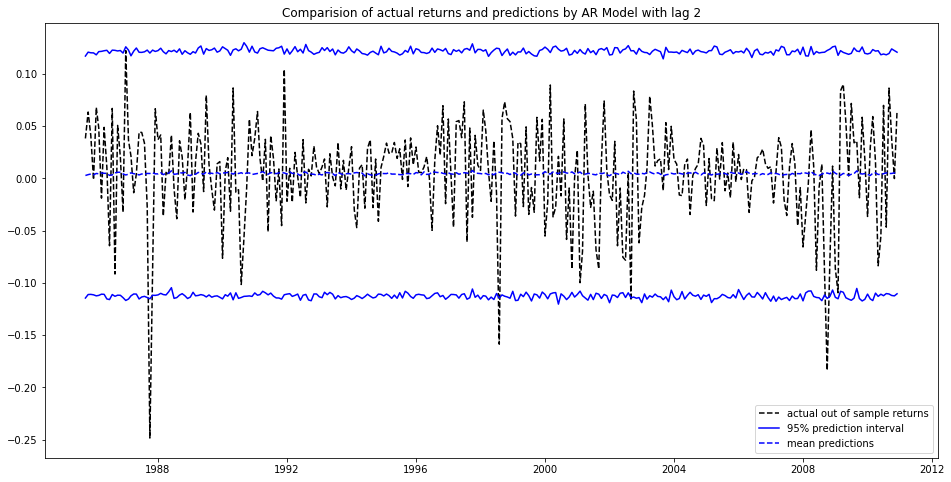

------------------------------------------------------------
Error scores for Auto Regression Model with Lag=2
------------------------------------------------------------
R2OS is  -0.00165268238374372
MSFE on test is  0.0021408215984218466
% of actual points outside of confidence interval:  0.013201320132013201


In [76]:
# Plotting samples and calculating error scores
n_outside_ci = plot_predictions(dict_samples['ar_lag_2']['y_pred'], 
                 dates_test, Y_test,
                 'AR Model with lag 2')

print('---'*20)
print('Error scores for Auto Regression Model with Lag=2')
print('---'*20)

calc_and_store_error_scores(dict_samples['ar_lag_2']['y_pred'], 
                            'ar_lag_2', n_outside_ci)

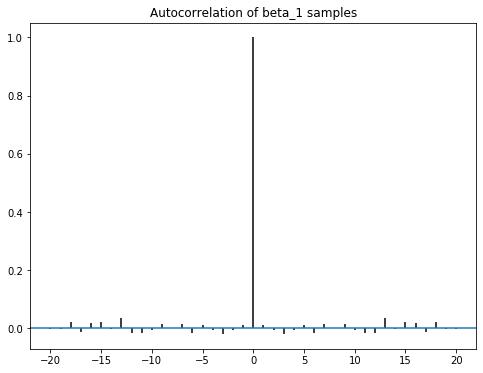

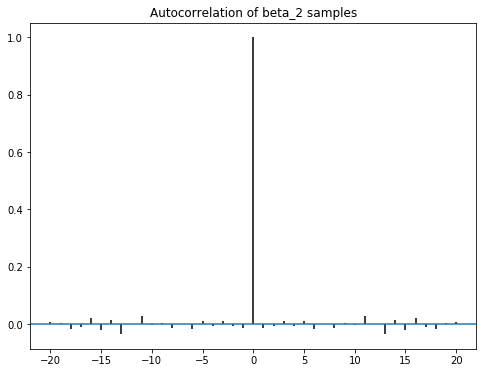

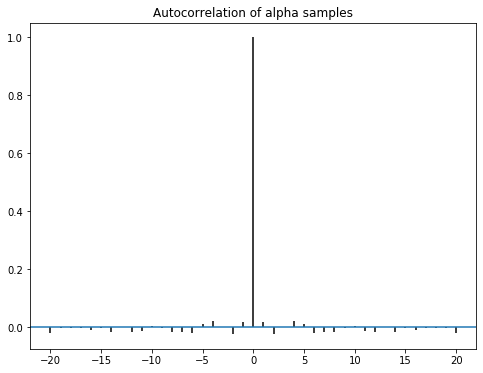

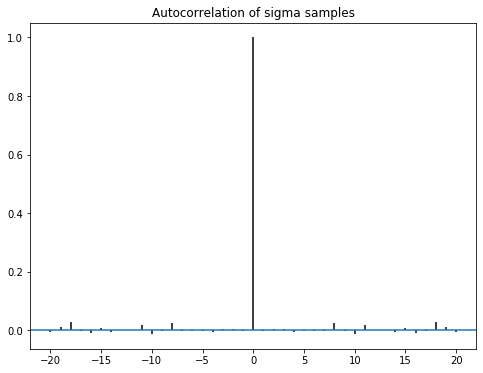

In [77]:
# Making Autocorrelation plot

samples = dict_samples['ar_lag_2']

for param in parameters:
    plt.figure(figsize=(8, 6))
    plot_acf(samples[param])
    plt.title(f'Autocorrelation of {param} samples')

plt.show()

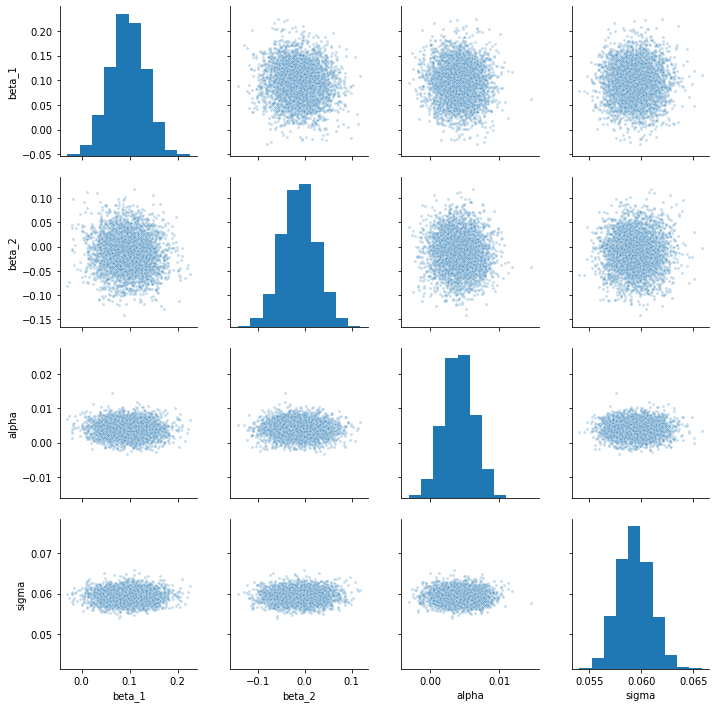

In [78]:
# Make pair plots of the posteriors over all parameters of the model.

df = pd.DataFrame(
    data=np.transpose([samples[param] for param in parameters]),
    columns=parameters)
seaborn.pairplot(df, height=2.5, plot_kws={'marker': '.', 'alpha': 0.25})
plt.show()

# Combined Models: Bayesian Linear Regression + Auto-regresssive combined model

## Combined Models: BLR + AR model with lag 1

In [79]:
# The Stan model. Running this cell compiles the Stan model, which takes
# some time

stan_code_ar_combo = """
data {

    int<lower=0> n_var;       // Number of predictor variables

    int<lower=0> num_in_sample;  // The out of sample cut off point
    int<lower=0> num_out_sample;   // Number of predictions to generate
    
    // Knwon predictors
    matrix[num_in_sample, n_var] X_train;    // data matrix for training
    matrix[num_out_sample, n_var] X_test;    // data matrix for predictions and testing

    // Known log excess returns
    real y_train[num_in_sample];  // log-returns for trainings
    real y_test[num_out_sample];   // log-returns from out of sample
    
    // Hyper parameters for priors
    // beta are the ceofficients of the predictors
    real beta_mean;  // The mean hyperparameter for prior of betas
    real beta_std;  // The std hyperparameter for prior of betas
    
    // sigma is the standard deviation
    real sigma_alpha;    // The alpha hyperparameter for prior of sigma
    real sigma_beta;     // The beta hyperparameter for prior of sigma
    
    // Hyper parameters for alpha (coefficients of auto-regressive part)
    real alpha_mean; 
    real alpha_std;
}

parameters {

    vector[n_var] beta;
    real alpha;
    real sigma;
}

transformed parameters {
    // transformed parameters
}

model {

    beta ~ normal(beta_mean, beta_std);
    alpha ~ normal(alpha_mean, alpha_std);
    sigma ~ gamma(sigma_alpha, sigma_beta);

    for (i in 2:num_in_sample) {
        y_train[i] ~ normal(dot_product(beta, X_train[i-1]) + alpha*y_train[i-1], sigma);
    }
}

// Generate the predicted function values for the next n_future steps.
generated quantities {
    real y_pred[num_out_sample];

    y_pred[1] = normal_rng(
        dot_product(beta, X_train[num_in_sample]) + alpha*y_train[num_in_sample],
        sigma
    );
    
    for(t in 2:num_out_sample) {
        y_pred[t] = normal_rng(
            dot_product(beta, X_test[t-1]) + alpha*y_pred[t-1],
            sigma);
    }
}
"""
start = time.time() # Timer started

stan_model_ar_combo = pystan.StanModel(model_code=stan_code_ar_combo)

print('--'*20)
print('Model compiled')
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_397224aac07a9047ad068b97c6739f14 NOW.


----------------------------------------
Model compiled
Time taken: 57.7179s


In [81]:
stan_data_ar_combo = {
    'n_var': X[:-1].shape[1],
    'num_in_sample': num_in_sample,
    'num_out_sample': num_out_sample,
    'X_train': X_train_norm,
    'X_test': X_test_norm,
    'y_train': Y_train,
    'y_test': Y_test,
    'beta_mean': 0,
    'beta_std': 1,
    'alpha_mean': 0,
    'alpha_std': 0.2,
    'sigma_alpha': 0.5,
    'sigma_beta': 1
} 

start = time.time() # Timer started

parameters = ['beta', 'sigma', 'alpha']
dict_results['ar_combo_lag_1'] = stan_model_ar_combo.sampling(data=stan_data_ar_combo)
print(dict_results['ar_combo_lag_1'].stansummary(pars=parameters))
dict_samples['ar_combo_lag_1'] = dict_results['ar_combo_lag_1'].extract()

print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

Inference for Stan model: anon_model_397224aac07a9047ad068b97c6739f14.
4 chains, each with iter=2000; warmup=1000; thin=1; 
post-warmup draws per chain=1000, total post-warmup draws=4000.

            mean se_mean     sd   2.5%     25%     50%    75%  97.5%  n_eff   Rhat
beta[1]  -6.4e-3  2.7e-3   0.08  -0.17   -0.06 -6.9e-3   0.05   0.16    912    1.0
beta[2]    -0.01    0.02   0.67  -1.37   -0.47   -0.01   0.44   1.27    913    1.0
beta[3]    -0.02  3.7e-3   0.16  -0.34   -0.12   -0.01   0.09   0.29   1896    1.0
beta[4]     0.02    0.02   0.57  -1.09   -0.37    0.02   0.39   1.16    900    1.0
beta[5]    -0.01    0.02   0.49  -0.97   -0.34 -6.4e-3   0.31   0.98    901    1.0
beta[6]   3.1e-3  2.9e-4   0.02  -0.03 -8.5e-3  3.1e-3   0.01   0.04   3452    1.0
beta[7]     0.04  3.6e-4   0.02 7.7e-3    0.03    0.04   0.06   0.08   2586    1.0
beta[8]  -5.2e-3  2.3e-4   0.01  -0.03   -0.01 -5.2e-3 3.3e-3   0.02   2999    1.0
beta[9]    -0.02    0.02   0.74  -1.45   -0.55   -0.01   0.51   

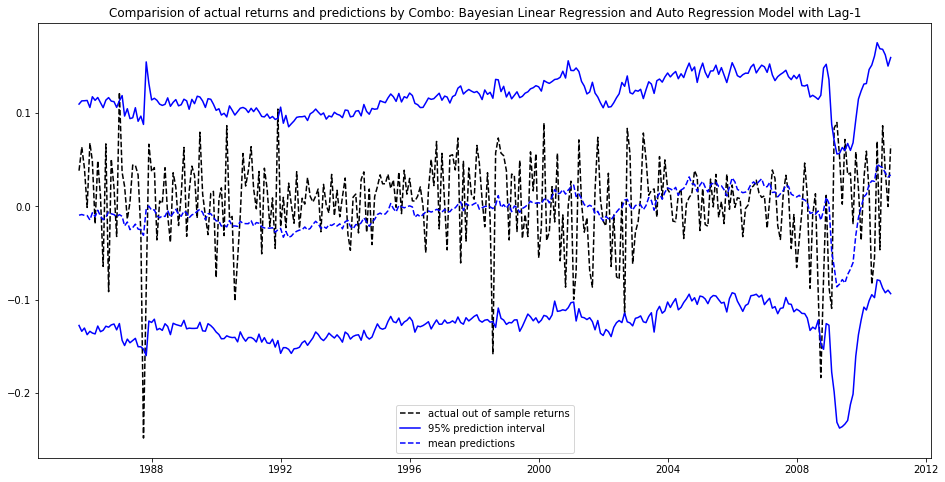

------------------------------------------------------------
Error scores for Combo: Bayesian Linear Regression and Auto Regression Model with Lag-1
------------------------------------------------------------
R2OS is  -0.24659965475994006
MSFE on test is  0.002664344150852952
% of actual points outside of confidence interval:  0.0297029702970297


In [84]:
# Plotting predictions and calculating error scores.

n_outside_ci = plot_predictions(dict_samples['ar_combo_lag_1']['y_pred'],
                 dates_test, Y_test, 
                 'Combo: Bayesian Linear Regression and Auto Regression Model with Lag-1')

print('---'*20)
print('Error scores for Combo: Bayesian Linear Regression and Auto Regression Model with Lag-1')
print('---'*20)

calc_and_store_error_scores(dict_samples['ar_combo_lag_1']['y_pred'], 
                            'ar_combo_lag_1', n_outside_ci)

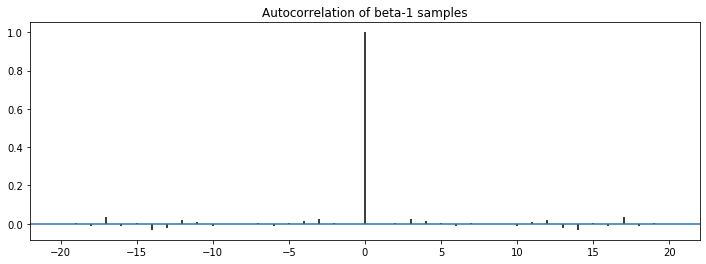

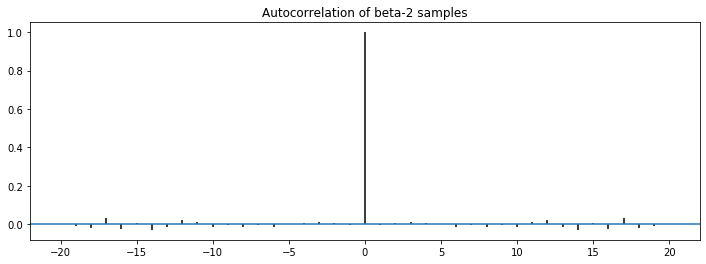

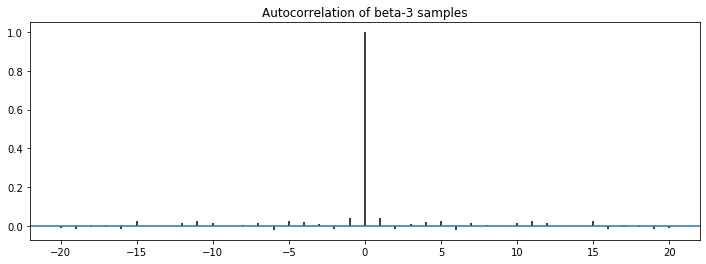

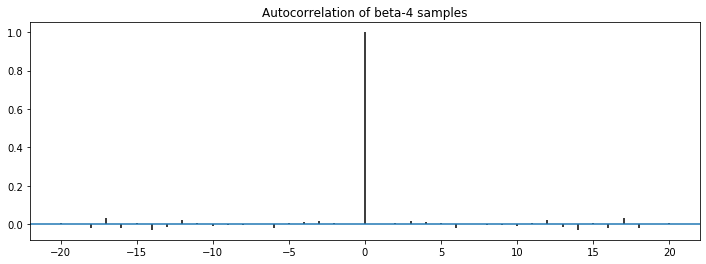

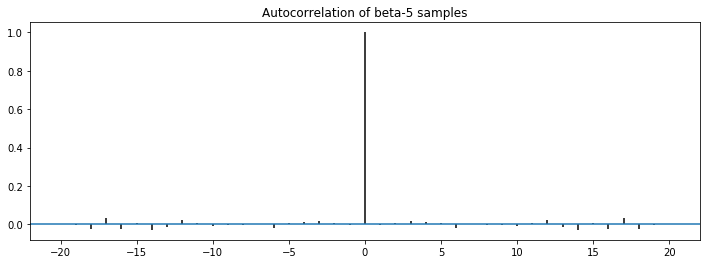

...

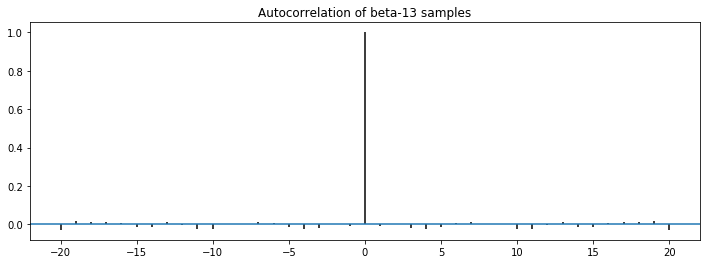

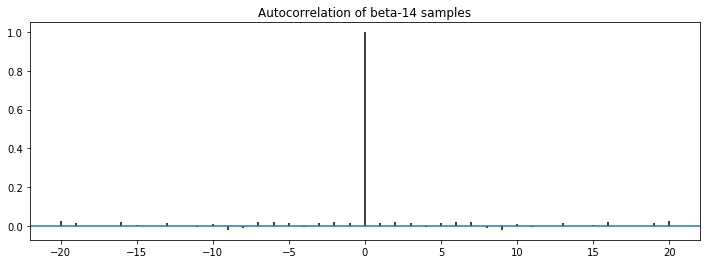

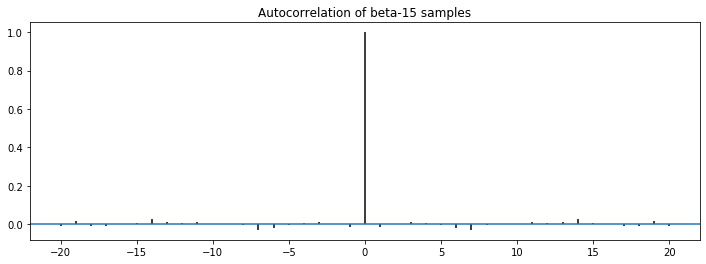

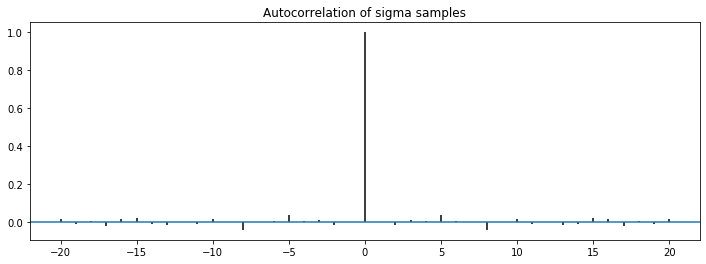

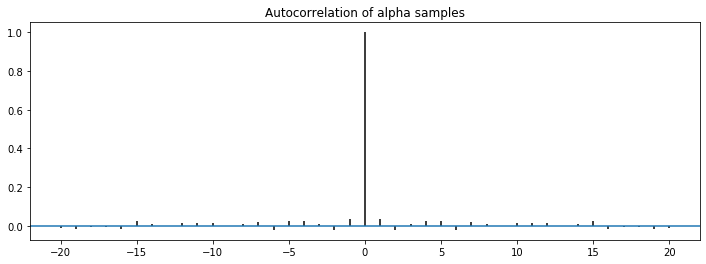

In [85]:
samples = dict_samples['ar_combo_lag_1']

# Making Autocorrelation plot

arr_data = [samples['beta'][:,i] for i in range(samples['beta'].shape[1])]
arr_data.append(samples['sigma'])
arr_data.append(samples['alpha'])

arr_params = ['beta-{0}'.format(i+1) for i in range(samples['beta'].shape[1])]
arr_params.append('sigma')
arr_params.append('alpha')

for i in range(len(arr_params)):
    plt.figure(figsize=(12, 4))
    plot_acf(arr_data[i])
    plt.title(f'Autocorrelation of {arr_params[i]} samples')

plt.show()

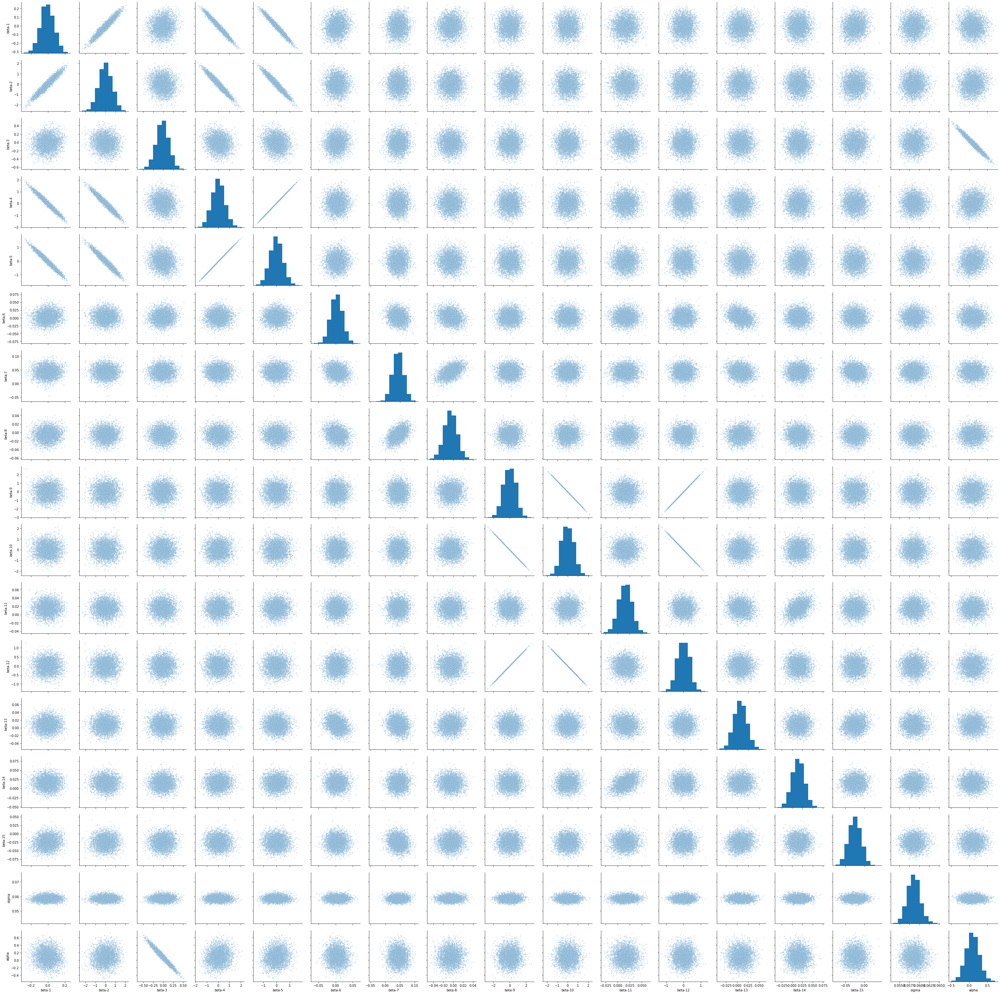

In [86]:
# Make pair plot of the posteriors over all parameters of the Bayesian linear regression model model.

df = pd.DataFrame(
    data=np.transpose(arr_data),
    columns=arr_params)
seaborn.pairplot(df, height=2.5, plot_kws={'marker': '.', 'alpha': 0.25})
plt.show()

## Combined Models: BLR + AR model with lag 2

In [87]:
stan_code_ar_combo_lag_2 = """
data {

    int<lower=0> n_var;       // Number of predictor variables

    int<lower=0> num_in_sample;  // The out of sample cut off point
    int<lower=0> num_out_sample;   // Number of predictions to generate
    
    // Knwon predictors
    matrix[num_in_sample, n_var] X_train;    // data matrix for training
    matrix[num_out_sample, n_var] X_test;    // data matrix for predictions and testing

    // Known log excess returns
    real y_train[num_in_sample];  // log-returns for trainings
    real y_test[num_out_sample];   // log-returns from out of sample
    
    // Hyper parameters for priors
    // beta are the ceofficients of the predictors
    real beta_mean;  // The mean hyperparameter for prior of betas
    real beta_std;  // The std hyperparameter for prior of betas
    
    // sigma is the standard deviation
    real sigma_alpha;    // The alpha hyperparameter for prior of sigma
    real sigma_beta;     // The beta hyperparameter for prior of sigma
    
    // Hyper parameters for alpha (coefficients of auto-regressive part)
    real alpha_mean; 
    real alpha_std;
}


parameters {

    vector[n_var] beta; // Coefficients for predictors
    real alpha_1;  // Coefficients for auto-regression variable y_train[i-1]
    real alpha_2;  // Coefficients for auto-regression Coefficients for auto-regression
    real sigma;     // Standard deviation
}

model {

    beta ~ normal(beta_mean, beta_std);
    alpha_1 ~ normal(alpha_mean, alpha_std);
    alpha_2 ~ normal(alpha_mean, alpha_std);
    sigma ~ gamma(sigma_alpha, sigma_beta);

    for (i in 3:num_in_sample) {
        y_train[i] ~ normal(
            dot_product(beta, X_train[i-1]) + alpha_1*y_train[i-1] + alpha_2*y_train[i-2], 
            sigma);
    }
}

// Generate the predicted function values for the next n_future steps.
generated quantities {
    real y_pred[num_out_sample];

    y_pred[1] = normal_rng(
        dot_product(beta, X_train[num_in_sample]) + alpha_1* y_train[num_in_sample] + alpha_2 * y_train[num_in_sample-1],
        sigma
    );
    y_pred[2] = normal_rng(
        dot_product(beta, X_test[1]) + alpha_1* y_pred[1] + alpha_2 * y_train[num_in_sample],
        sigma
    );
    
    for(t in 3:num_out_sample) {
        y_pred[t] = normal_rng(
            dot_product(beta, X_test[t-1]) + alpha_1*y_pred[t-1] + alpha_2*y_pred[t-2],
            sigma);
    }

}
"""

start = time.time() # timer started
 
stan_model_ar_combo_lag_2 = pystan.StanModel(model_code=stan_code_ar_combo_lag_2)

print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_7d5d674ccb404e8d88f805f830ce89a4 NOW.


----------------------------------------
Time taken: 58.8854s


In [88]:
stan_data_ar_combo = {
    'n_var': X[:-1].shape[1],
    'num_in_sample': num_in_sample,
    'num_out_sample': num_out_sample,
    'X_train': X_train_norm,
    'X_test': X_test_norm,
    'y_train': Y_train,
    'y_test': Y_test,
    'beta_mean': 0,
    'beta_std': 1,
    'alpha_mean': 0,
    'alpha_std': 0.2,
    'sigma_alpha': 0.5,
    'sigma_beta': 1
} 


start = time.time() # timer started

parameters = ['beta', 'sigma', 'alpha_1', 'alpha_2']
dict_results['ar_combo_lag_2'] = stan_model_ar_combo_lag_2.sampling(data=stan_data_ar_combo)
print(dict_results['ar_combo_lag_2'].stansummary(pars=parameters))
dict_samples['ar_combo_lag_2'] = dict_results['ar_combo_lag_2'].extract()

print('--'*20)
print('Time taken: {0:.4f}s'.format(time.time() - start)) #timer ended

# Making beeps to signify completion of this cell
beep()

Inference for Stan model: anon_model_7d5d674ccb404e8d88f805f830ce89a4.
4 chains, each with iter=2000; warmup=1000; thin=1; 
post-warmup draws per chain=1000, total post-warmup draws=4000.

            mean se_mean     sd   2.5%     25%     50%    75%  97.5%  n_eff   Rhat
beta[1]  -9.1e-3  3.1e-3   0.08  -0.16   -0.06 -8.7e-3   0.05   0.15    693    1.0
beta[2]    -0.03    0.02   0.66   -1.3   -0.47   -0.03   0.41    1.3    755    1.0
beta[3]    -0.02  4.0e-3   0.16  -0.34   -0.12   -0.02   0.09    0.3   1628    1.0
beta[4]     0.03    0.02   0.56   -1.1   -0.33    0.03   0.41   1.11    686   1.01
beta[5]   2.8e-4    0.02   0.48  -0.97   -0.31 -7.6e-4   0.33   0.93    685   1.01
beta[6]   2.3e-3  3.2e-4   0.02  -0.03 -9.7e-3  2.3e-3   0.01   0.04   2982    1.0
beta[7]     0.04  3.3e-4   0.02 7.4e-3    0.03    0.04   0.06   0.08   3180    1.0
beta[8]  -5.1e-3  2.3e-4   0.01  -0.03   -0.01 -5.0e-3 3.5e-3   0.02   2962    1.0
beta[9]    -0.04    0.02   0.73  -1.42   -0.55   -0.01   0.48   

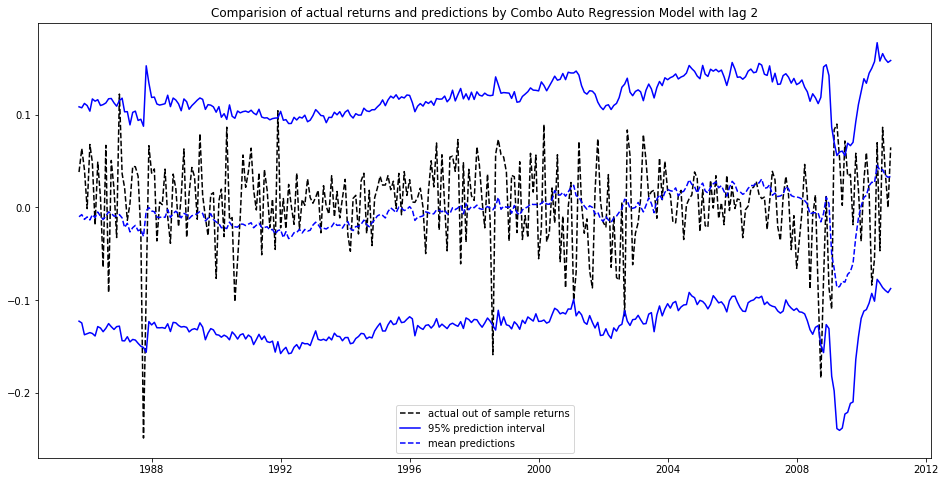

------------------------------------------------------------
Error scores for Combo: Bayesian Linear Regression and Auto Regression Model with Lag=2
------------------------------------------------------------
R2OS is  -0.24773952596147963
MSFE on test is  0.002666780385418677
% of actual points outside of confidence interval:  0.033003300330033


In [90]:
# Plotting predictions and calculating error scores.

n_outside_ci = plot_predictions(dict_samples['ar_combo_lag_2']['y_pred'], 
                 dates_test, Y_test,
                 'Combo Auto Regression Model with lag 2')

print('---'*20)
print('Error scores for Combo: Bayesian Linear Regression and Auto Regression Model with Lag=2')
print('---'*20)

calc_and_store_error_scores(dict_samples['ar_combo_lag_2']['y_pred'], 
                            'ar_combo_lag_2', n_outside_ci)


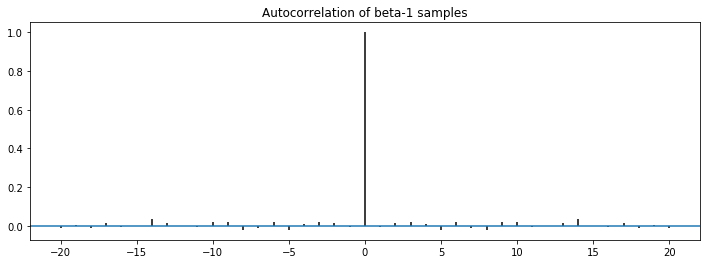

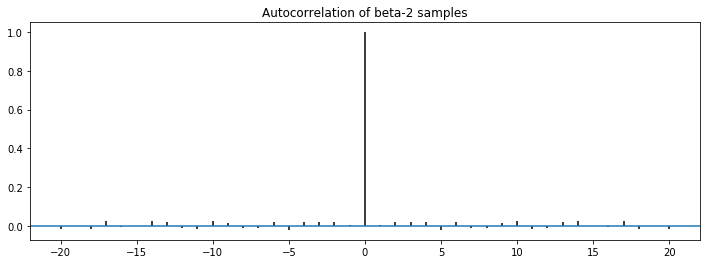

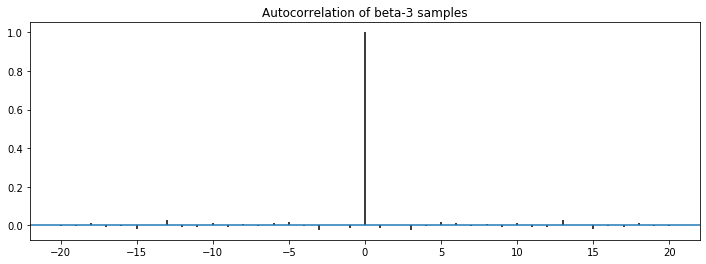

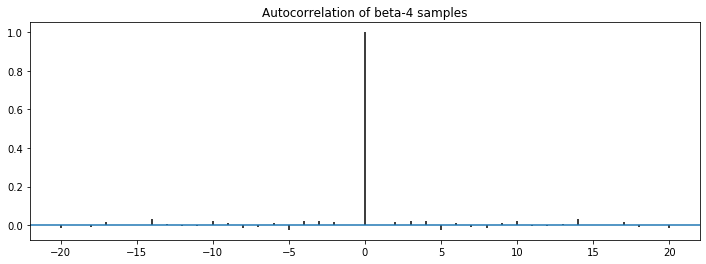

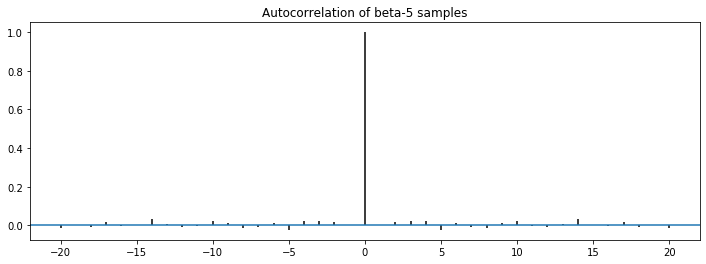

...

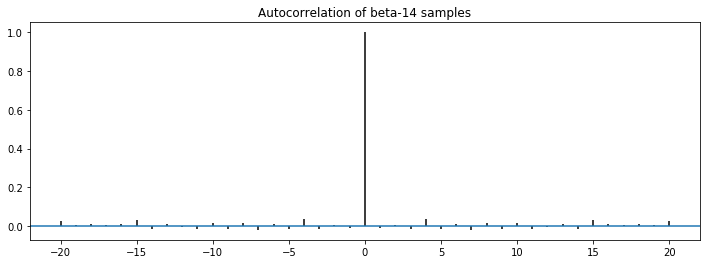

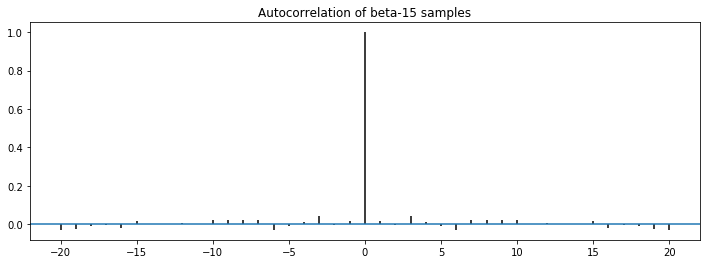

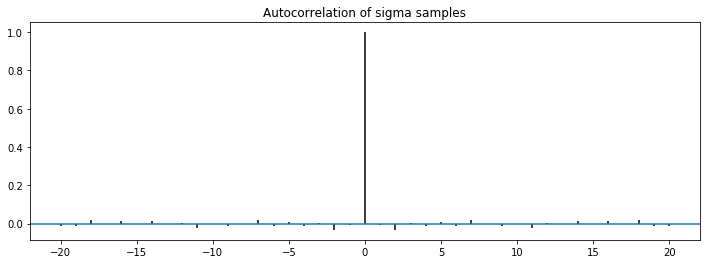

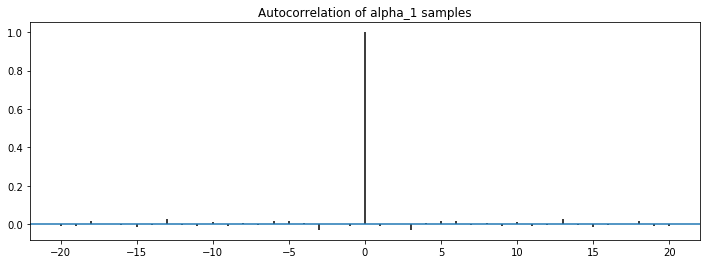

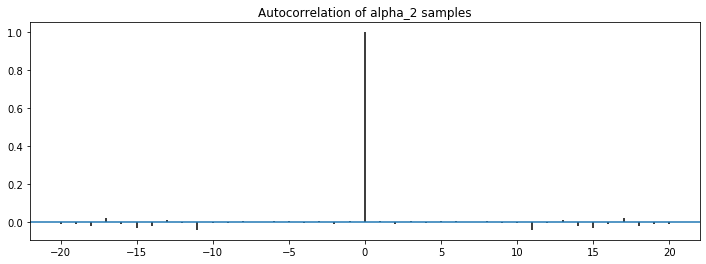

In [91]:
samples = dict_samples['ar_combo_lag_2']

# Making Autocorrelation plot
#parameters = ['beta', 'sigma', 'alpha_1', 'alpha_2']

arr_data = [samples['beta'][:,i] for i in range(samples['beta'].shape[1])]
arr_data.append(samples['sigma'])
arr_data.append(samples['alpha_1'])
arr_data.append(samples['alpha_2'])

arr_params = ['beta-{0}'.format(i+1) for i in range(samples['beta'].shape[1])]
arr_params.append('sigma')
arr_params.append('alpha_1')
arr_params.append('alpha_2')

for i in range(len(arr_params)):
    plt.figure(figsize=(12, 4))
    plot_acf(arr_data[i])
    plt.title(f'Autocorrelation of {arr_params[i]} samples')

plt.show()


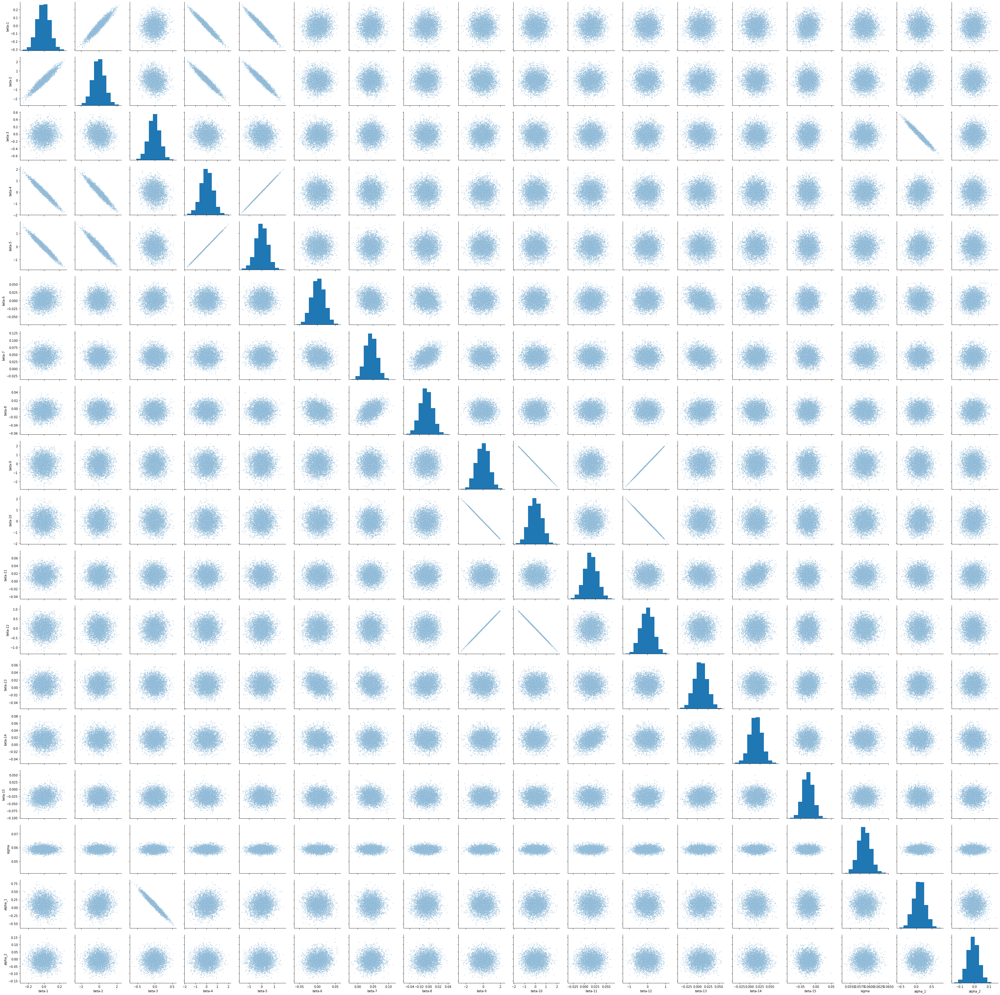

In [92]:
# Make pair plot of the posteriors over all parameters of the Bayesian linear regression model model.

df = pd.DataFrame(
    data=np.transpose(arr_data),
    columns=arr_params)
seaborn.pairplot(df, height=2.5, plot_kws={'marker': '.', 'alpha': 0.25})
plt.show()

## Comparing performance

In [94]:
arr_r2os = []
arr_msfe = []
arr_data_outside_ci = []
arr_model_name = ['Bayesian Linear Regression model',
                  'AR model with lag = 1',
                  'AR model with lag = 2',
                  'Combined BLR and AR model with lag = 1',
                  'Combined BLR and AR model with lag = 2']

for key in dict_msfe:
    arr_r2os.append(dict_r2os[key])
    arr_msfe.append(dict_msfe[key])
    arr_data_outside_ci.append(dict_data_outside_ci[key])

df_msfe = pd.DataFrame(data={
                            'Model':arr_model_name,
                             'R2os':arr_r2os,
                             'MSFE':arr_msfe,
                             '% of data outside of 95% confidence interval': arr_data_outside_ci        
                            })

df_msfe

,Model,R2os,MSFE,% of data outside of 95% confidence interval
0,Bayesian Linear Regression model,-0.021602,0.002183,0.019802
1,AR model with lag = 1,-0.001348,0.002140,0.016502
2,AR model with lag = 2,-0.001653,0.002141,0.013201
3,Combined BLR and AR model with lag = 1,-0.246600,0.002664,0.029703
4,Combined BLR and AR model with lag = 2,-0.247740,0.002667,0.033003
